In [1]:
# --- Config ---
import sys
import os
sys.path.append(os.path.abspath(".."))
from modules.config_utils import load_config
CONFIG_PATH = "../config.yml"
CONFIG = load_config(str(CONFIG_PATH))
print("Output directory:", CONFIG.get("output_dir"))

Output directory: ../data/todelete


In [2]:
# --- wildfire settings ---
from pathlib import Path

wf_conf = CONFIG.get("hazards", {}).get("wildfire", {}) or {}
wf_active = bool(wf_conf.get("active", False))
wf_input  = wf_conf.get("input")

print("Wildfire active:", wf_active)
print("GlobFire folder:", wf_input)

# Show how many .shp files are present (if folder exists)
if wf_input and Path(wf_input).exists():
    shp_count = len([p for p in Path(wf_input).glob("*.shp")])
    print("Shapefiles found:", shp_count)
else:
    print("Wildfire input folder is missing.")

Wildfire active: True
GlobFire folder: /Users/nassimdekkar/Downloads/GLOBFIRE_burned_area_full_dataset_2002_2023
Shapefiles found: 22


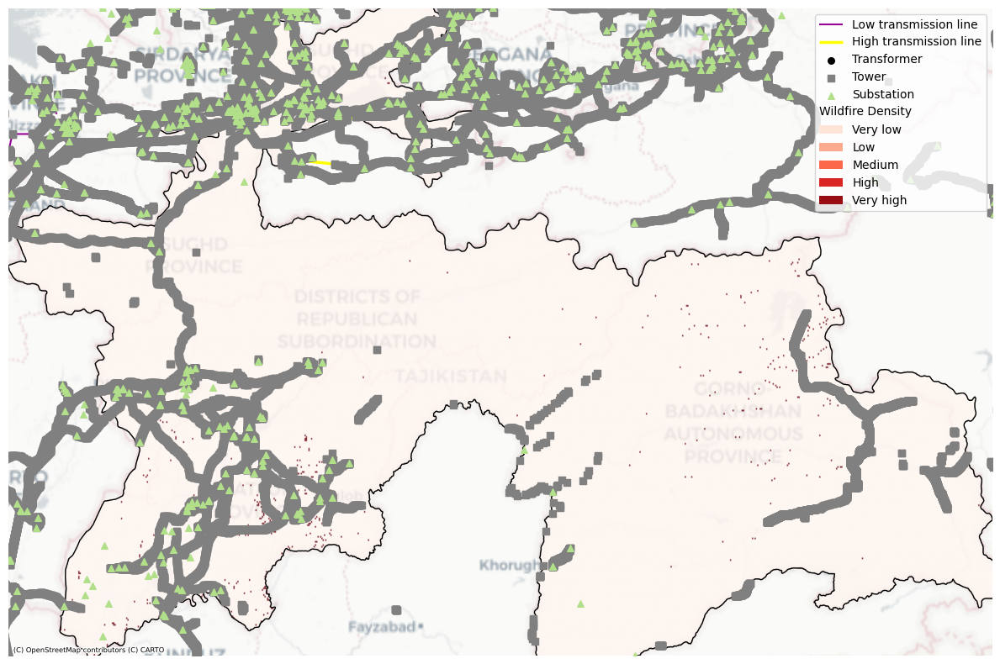

[INFO] Wildfire map written: ../data/todelete/wildfire_w_network.png
Exported raster: ../data/todelete/wildfire_centroids.tif


In [3]:
# --- Run wildfire processing ---
from modules.wildfire_module import process_wildfire

out_dir = Path(CONFIG["output_dir"])
out_dir.mkdir(parents=True, exist_ok=True)

if not wf_active:
    raise RuntimeError("Wildfire hazard is not active in your config. Set hazards.wildfire.active: true")

if not wf_input or not Path(wf_input).exists():
    raise FileNotFoundError(f"Wildfire input folder not found: {wf_input}")

raster_path = process_wildfire(CONFIG)
print("Exported raster:", raster_path)

Found PNGs: 11
PNG: ../data/todelete/00_initial_network_map.png


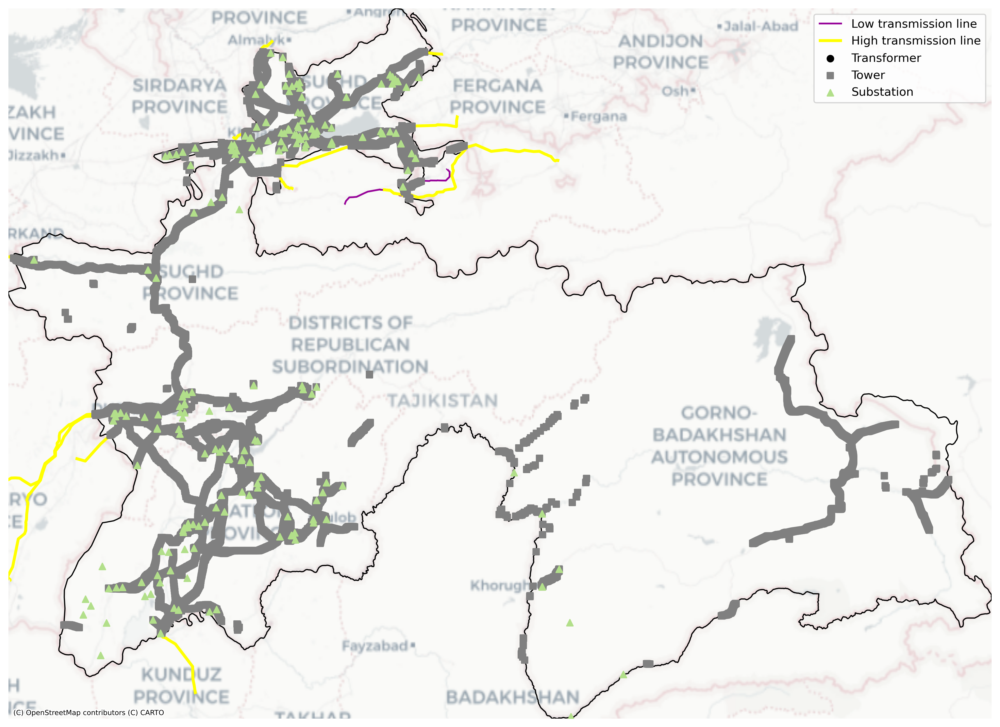

PNG: ../data/todelete/HotD2.png


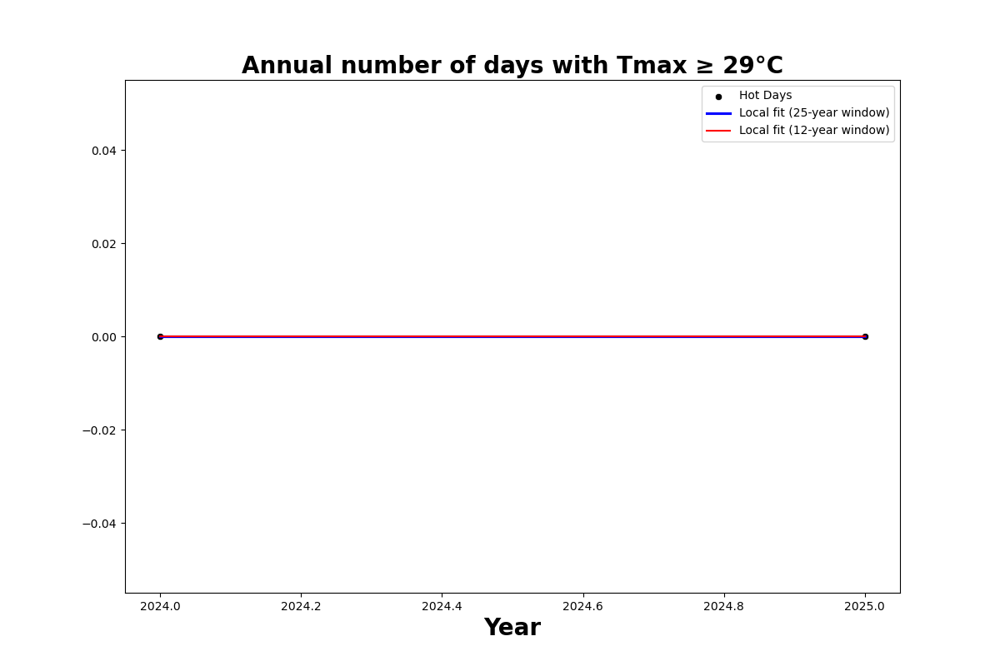

PNG: ../data/todelete/Tmax2.png


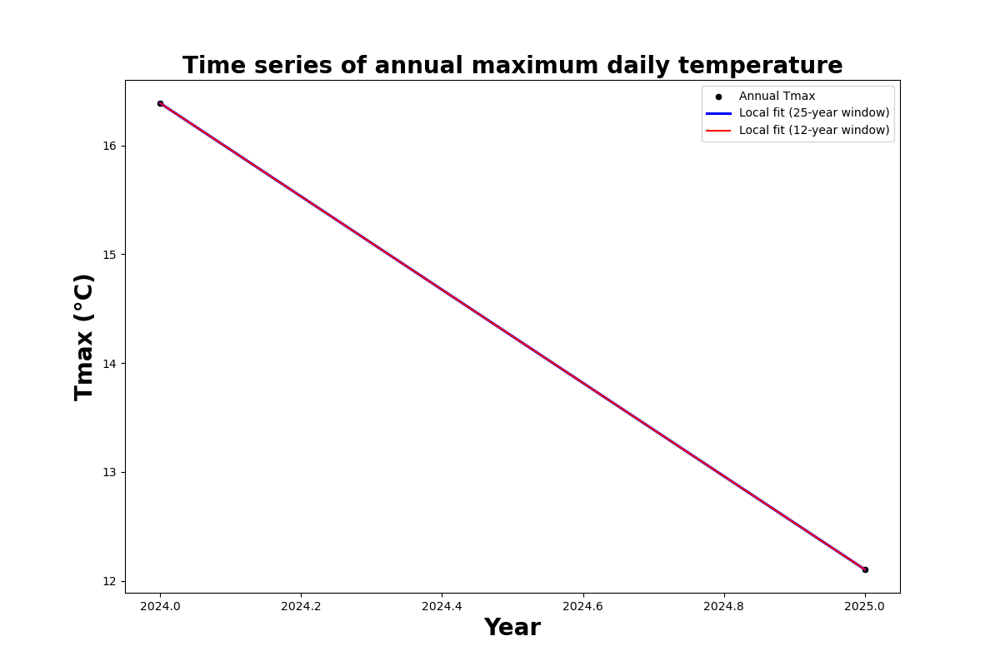

PNG: ../data/todelete/exposure_map_combined_flood.png


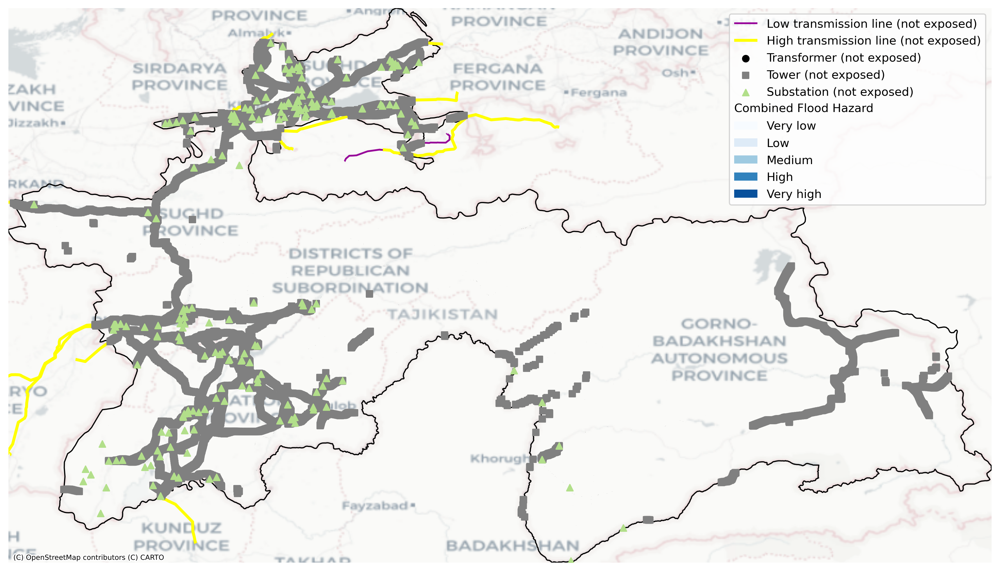

PNG: ../data/todelete/exposure_map_earthquake.png


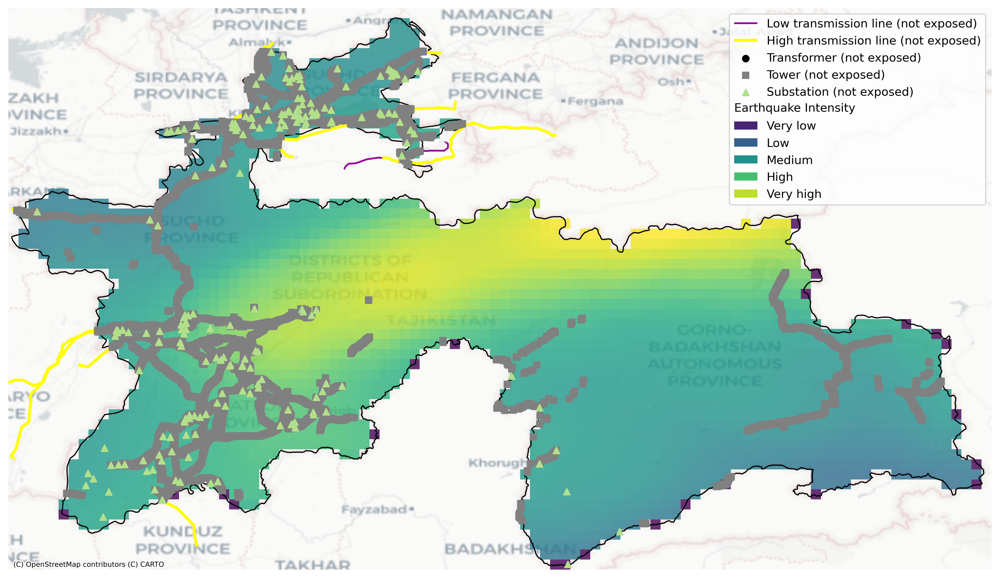

PNG: ../data/todelete/exposure_map_fluvial_flood.png


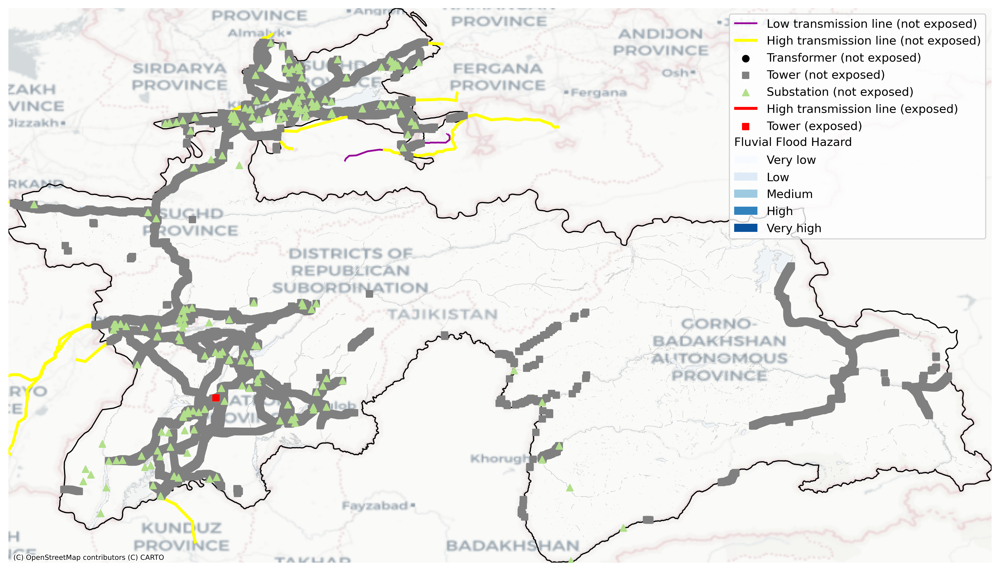

PNG: ../data/todelete/exposure_map_landslide.png


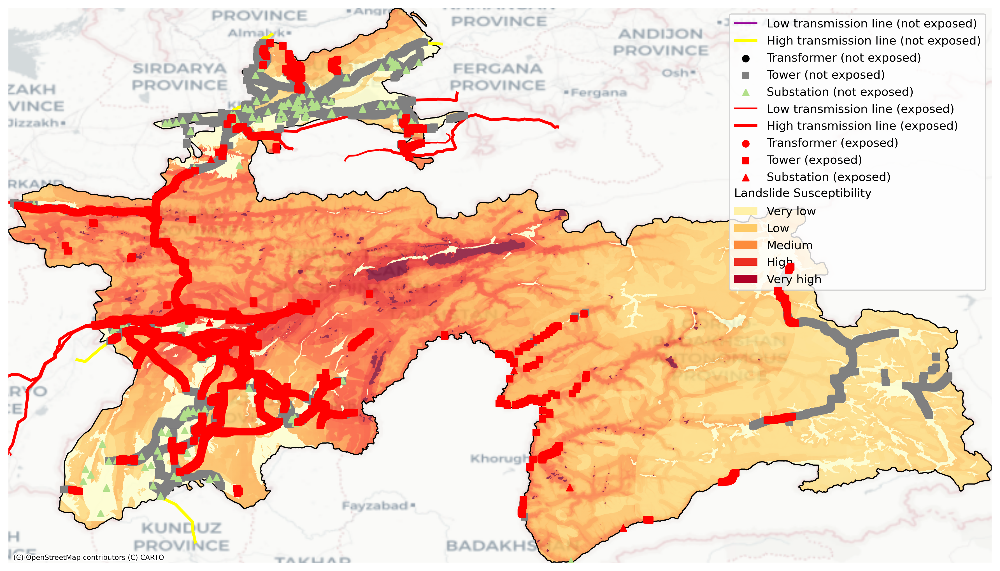

PNG: ../data/todelete/exposure_map_pluvial_flood.png


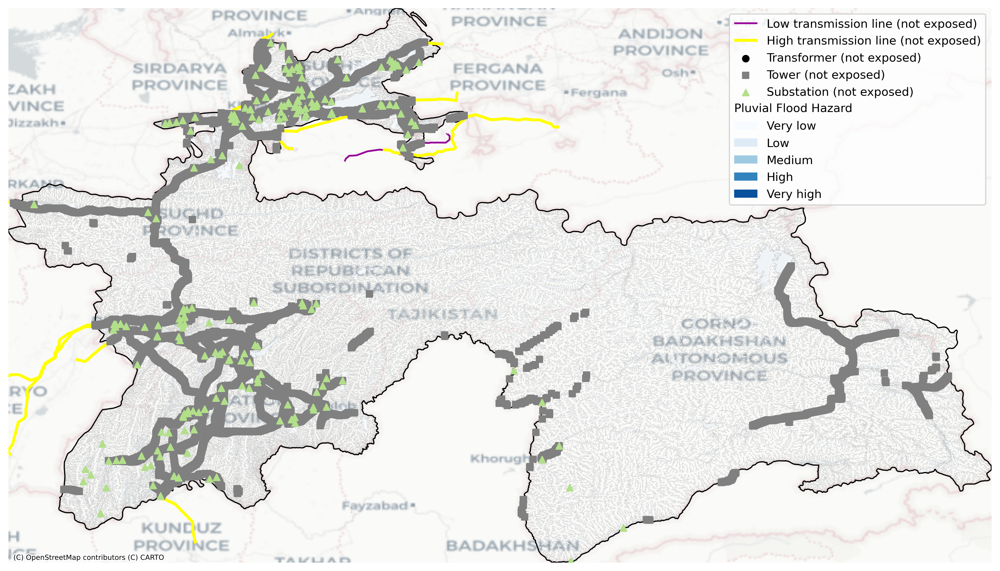

PNG: ../data/todelete/initial_by_type_earthquake.png


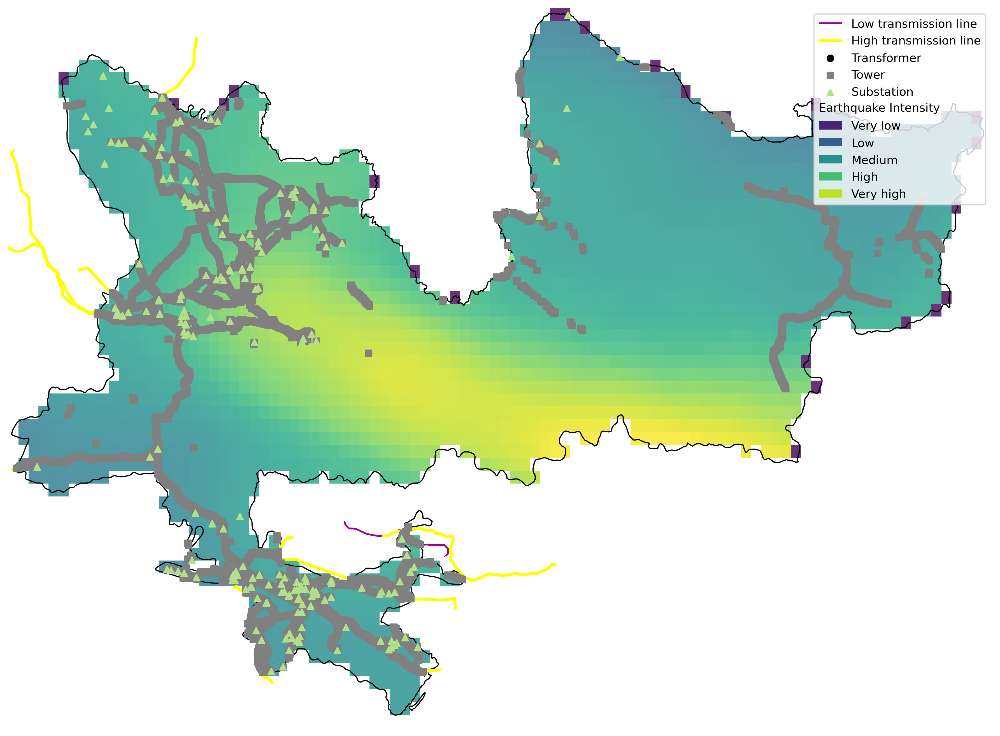

PNG: ../data/todelete/initial_context_map.png


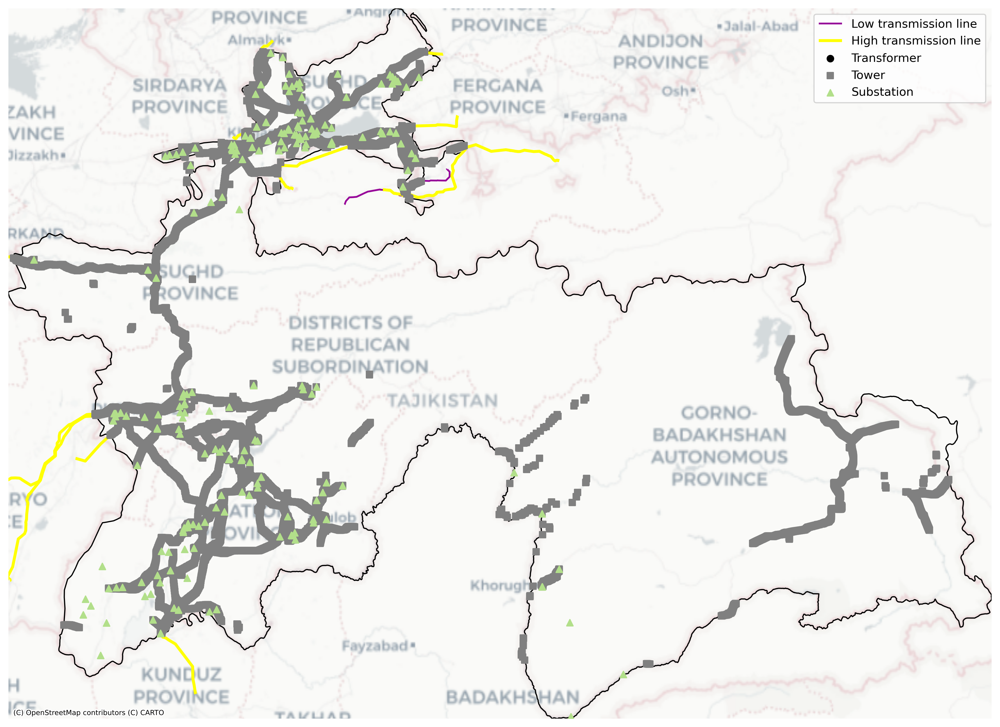

PNG: ../data/todelete/wildfire_w_network.png


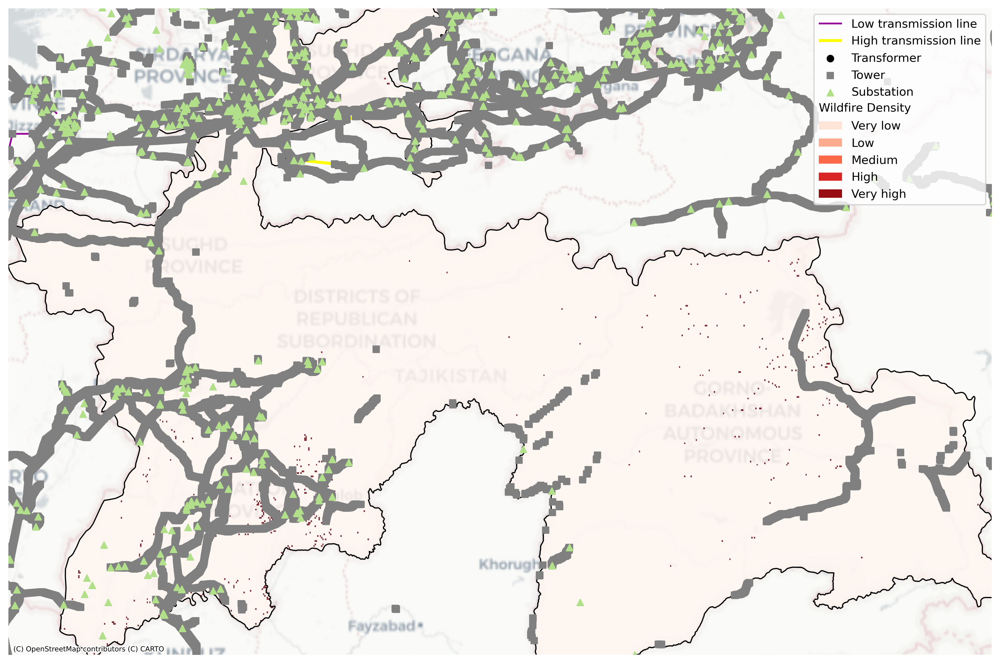

In [4]:
# --- Display generated PNGs (if any) ---
import glob
from IPython.display import Image, display

pngs = sorted(glob.glob(str(out_dir / "*.png")))
print("Found PNGs:", len(pngs))
for p in pngs:
    print("PNG:", p)
    display(Image(filename=p))

In [5]:
# --- Preview wildfire centroids (GPKG) if present ---
from pathlib import Path
import geopandas as gpd

gpkg_path = out_dir / "wildfire_centroids.gpkg"
if gpkg_path.exists():
    try:
        gdf = gpd.read_file(gpkg_path, layer="burned_area_centroids")
        print("Centroids count:", len(gdf))
        display(gdf.head(10).drop(columns=[c for c in gdf.columns if c.startswith("geometry")], errors="ignore"))
    except Exception as e:
        print("Could not read centroids:", e)
else:
    print("No GPKG found at", gpkg_path)

Centroids count: 626


""
0
1
2
3
4
5
6
7
8
9


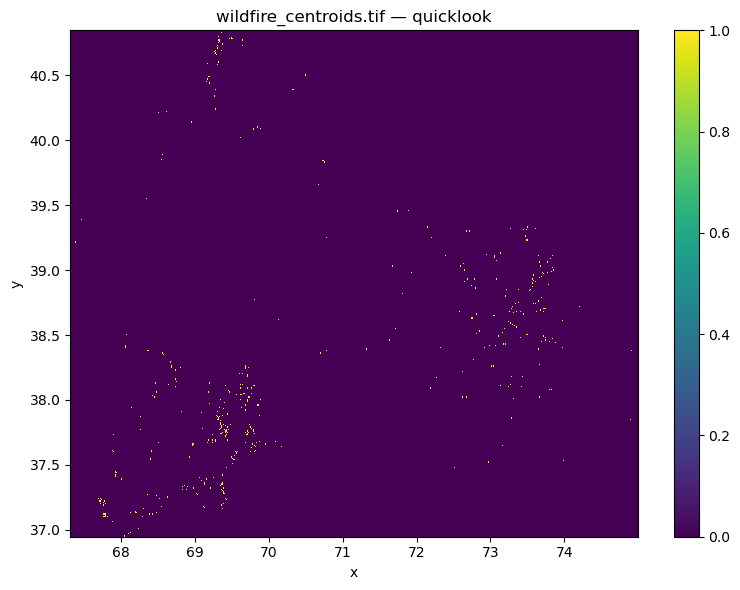

In [6]:
# --- Optional: raster quicklook for wildfire_centroids.tif ---
# Requires rioxarray/xarray + matplotlib
try:
    import rioxarray as rxr
    import matplotlib.pyplot as plt

    tif_path = out_dir / "wildfire_centroids.tif"
    if tif_path.exists():
        da = rxr.open_rasterio(tif_path).squeeze()
        plt.figure(figsize=(8, 6))
        da.plot()  # default colors/style
        plt.title(tif_path.name + " — quicklook")
        plt.tight_layout()
        plt.show()
    else:
        print("No TIF found at", tif_path)
except Exception as e:
    print("Quicklook skipped:", e)